### Peer-graded Assignment: Week 5: GANs


In [1]:
# Standard library
import os
import shutil
import time
from pathlib import Path
from typing import List, Tuple, Union

# Third-party libraries
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
from PIL import Image
from tensorflow.keras import layers

##### Brief Overview of the Problem and Data

The competition challenges you to produce 7,000–10,000 images that convincingly mimic Claude Monet’s style—so convincingly, in fact, that a trained classifier cannot tell them apart from genuine Monet paintings.

You’re given:

    300 Monet paintings (256×256 pixels, JPEG)

    7,028 photographs (256×256 pixels, JPEG)

The primary approach is to train a Generative Adversarial Network (GAN) on the Monet paintings to learn and reproduce Monet’s brushwork and color palette, then apply that learned style to the photographs. An alternative is to train a GAN from scratch to generate Monet-like images without conditioning on the photos—this is the strategy we’ve chosen.

For faster data handling in TensorFlow, the dataset also includes all paintings and photos in TFRecord format, which we will use throughout our project.


##### Exploratory Data Analysis (EDA): Data Inspection, Visualization, and Cleaning

In this section, we will:

    Confirm that all files are accessible and correctly formatted.

    Verify the dataset contains exactly 300 Monet paintings and 7,028 photographs.

    Display a selection of images from each set for visual inspection.

    Analyze and compare the color distributions of the paintings versus the photos.


In [3]:
def count_images_in_folder(folder_path: str) -> int:
    """
    Counts image files in a given directory.

    Args:
        folder_path (str): Path to the directory that contains images.

    Returns:
        int: Number of image files in the directory.
    """
    # Image extensions to check (expand as needed)
    image_extensions: Tuple[str, ...] = ('.jpg',)  # '.jpeg', '.png', '.gif', '.bmp', '.tiff', '.webp'

    # Lazy generator over directory contents—avoids loading everything into memory
    files_in_folder = Path(folder_path).iterdir()

    # Count files with matching extensions (case-insensitive)
    image_count = sum(
        1
        for file in files_in_folder
        if file.is_file() and file.suffix.lower() in image_extensions
    )

    return image_count

In [4]:
def display_images(path: str) -> None:
    """
    Displays up to the first nine JPEG images in a directory on a 3 × 3 grid.

    Args:
        path (str): Directory containing the images.
    """
    # Collect .jpg files (case-insensitive) without loading the full list into memory
    files: List[str] = [
        str(p) for p in Path(path).iterdir()
        if p.is_file() and p.suffix.lower() == ".jpg"
    ]

    # Select the first nine images (or fewer if not enough exist)
    files = files[:9]

    if not files:                       # Quick exit when no images are present
        print(f"No .jpg images found in '{path}'.")
        return

    # Set up a 3 × 3 matplotlib grid
    fig, axes = plt.subplots(3, 3, figsize=(10, 10))
    axes = axes.ravel()

    # Display each image with its filename as the title
    for ax, img_path in zip(axes, files):
        with Image.open(img_path) as img:   # Context manager ensures the file is closed
            ax.imshow(img)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(os.path.basename(img_path))

    # Hide unused axes if fewer than nine images
    for ax in axes[len(files):]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()


In [5]:
def compare_image_colors_normalized(path1: str, path2: str) -> None:
    """
    Compares the normalized average RGB values between two sets of images from different folders,
    using distinct color shades for better visual distinction.

    Args:
        path1 (str): Path to the first directory containing pictures.
        path2 (str): Path to the second directory containing paintings.
    """
    def get_avg_colors(image_folder: str) -> np.ndarray:
        # Gather image files lazily (case-insensitive)
        image_files = [
            str(p) for p in Path(image_folder).iterdir()
            if p.is_file() and p.suffix.lower() in ('.png', '.jpg', '.jpeg')
        ]

        # Calculate channel-wise means for each image
        avg_colors = [
            np.array(Image.open(file).convert('RGB')).mean(axis=(0, 1))
            for file in image_files
        ]
        return np.vstack(avg_colors) if avg_colors else np.empty((0, 3))
    
    # Get average colors for both directories
    avg_colors1 = get_avg_colors(path1)  # Pictures
    avg_colors2 = get_avg_colors(path2)  # Paintings

    # Quick exit if either folder lacks supported images
    if not (len(avg_colors1) and len(avg_colors2)):
        print("One or both directories contain no supported images.")
        return
    
    # Plotting
    fig, axes = plt.subplots(3, 1, figsize=(8, 10), sharex=True)
    color_labels = ['Red', 'Green', 'Blue']
    dark_shades = ['darkred', 'darkgreen', 'darkblue']     # Darker shades for pictures
    pastel_shades = ['salmon', 'lightgreen', 'lightblue']  # Pastel shades for paintings
    bins = np.linspace(0, 255, 31)                         # 30 equal-width bins
    
    for i in range(3):
        axes[i].hist(
            avg_colors1[:, i],
            bins=bins,
            alpha=0.7,
            label='Pictures',
            color=dark_shades[i],
            density=True
        )
        axes[i].hist(
            avg_colors2[:, i],
            bins=bins,
            alpha=0.7,
            label='Paintings',
            color=pastel_shades[i],
            density=True,
            linestyle='dashed'
        )
        axes[i].set_title(f'Normalized Comparison of {color_labels[i]} Channel')
        axes[i].legend(loc='upper right')

    plt.tight_layout()
    plt.show()

In [10]:
# Overview of available files
Input = 'gan-getting-started/'
print(os.listdir(Input))

['photo_jpg', 'monet_jpg', 'photo_tfrec', 'monet_tfrec']


In [11]:
# Count number of pictures
count_images_in_folder(Input + '/photo_jpg')

7038

In [12]:
# Count number of paintings
count_images_in_folder(Input + '/monet_jpg')

300

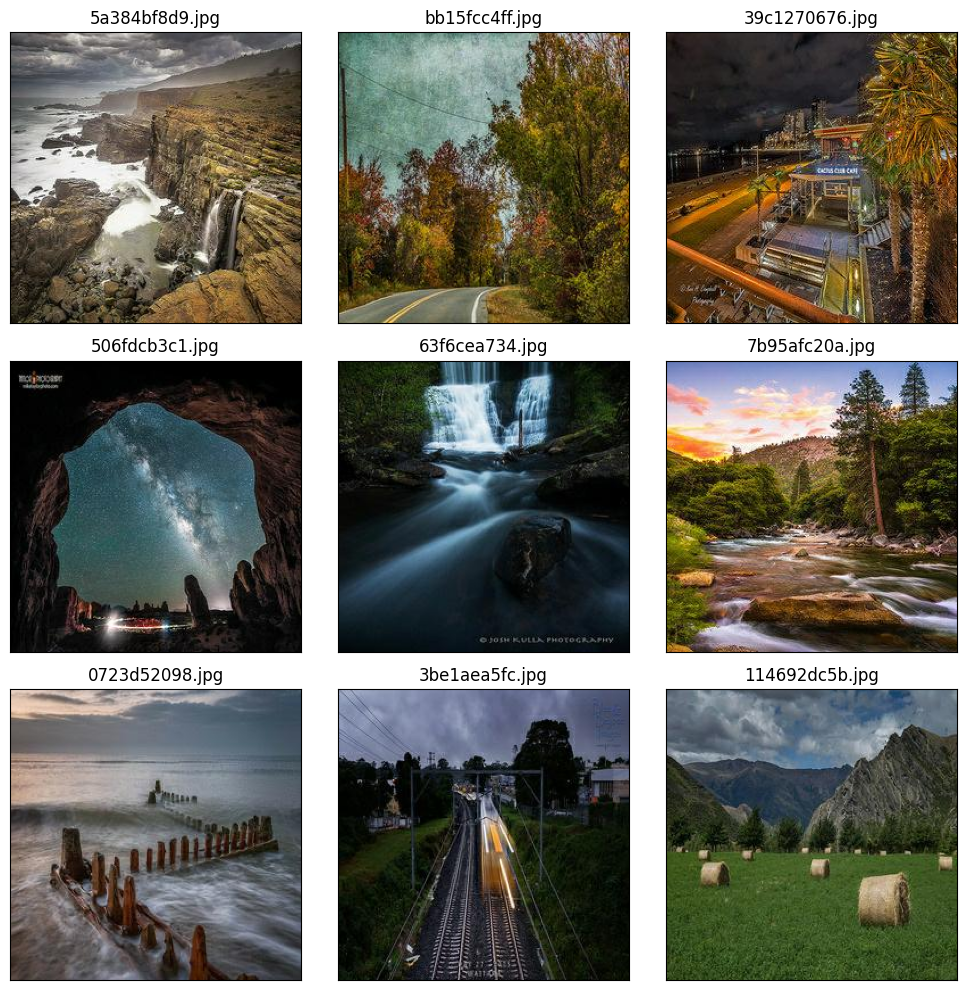

In [13]:
# Photo
display_images(Input + '/photo_jpg')

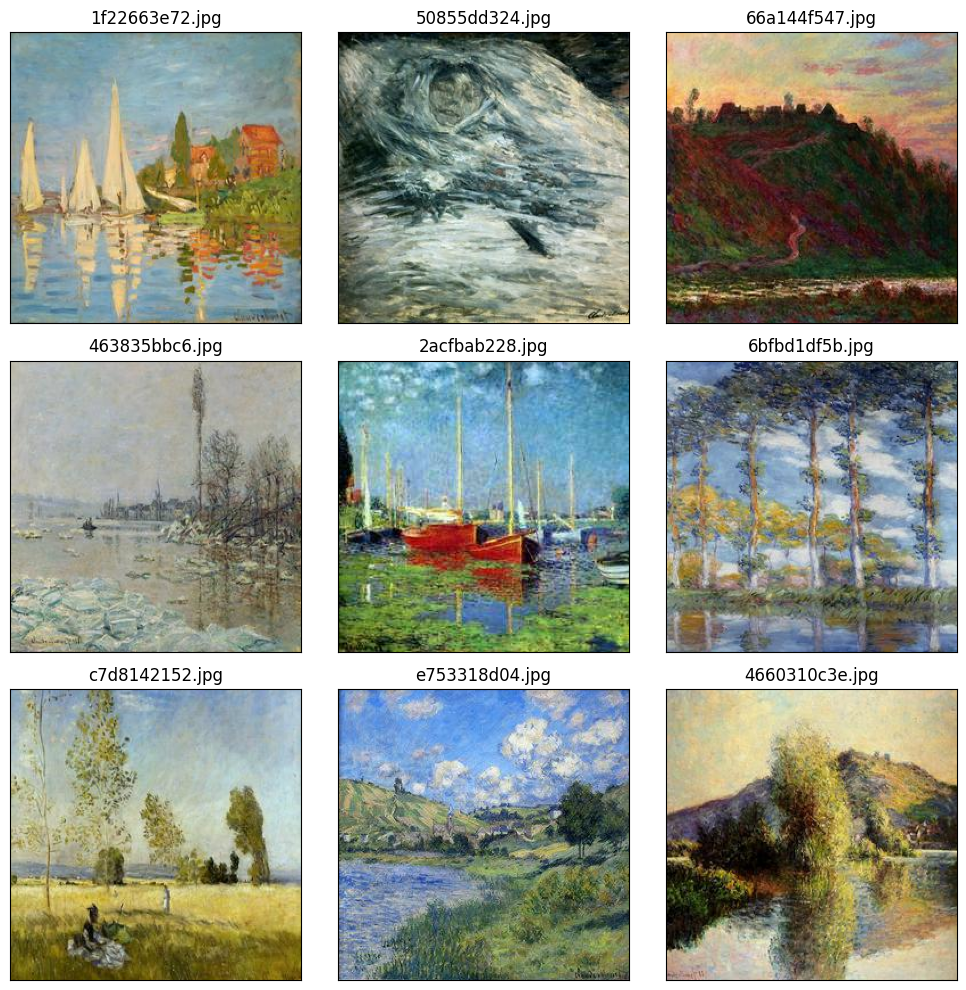

In [14]:
# Monet Paintings
display_images(Input + '/monet_jpg')

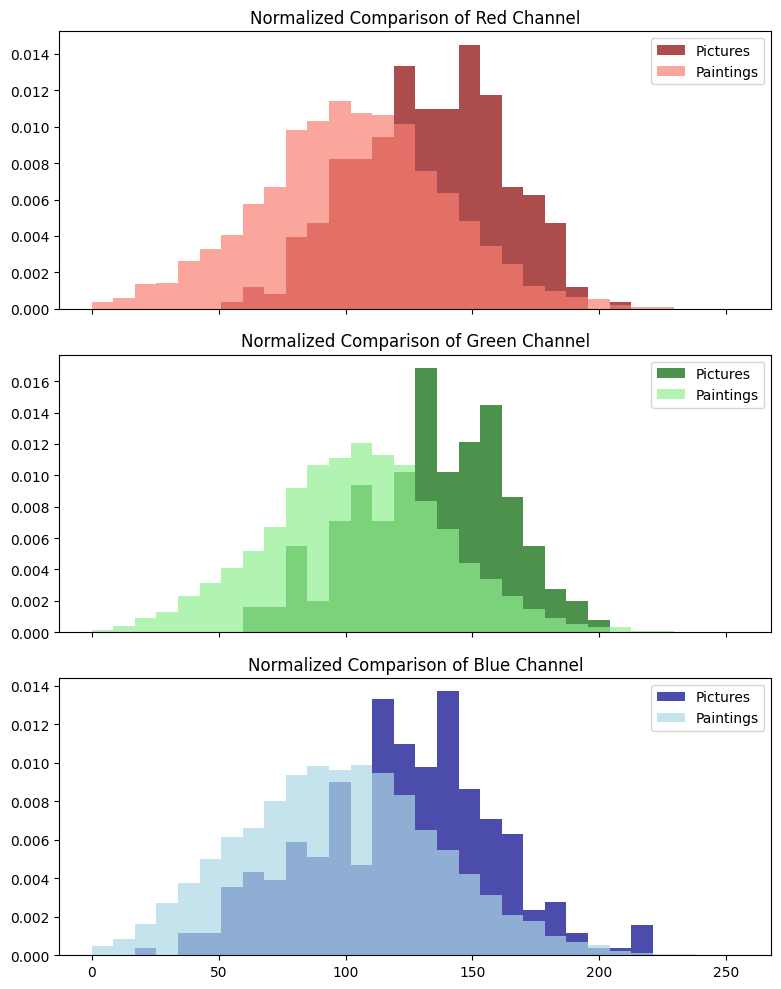

In [15]:
compare_image_colors_normalized(Input + '/monet_jpg', Input + '/photo_jpg')

### Model Architecture

We employ a Deep Convolutional Generative Adversarial Network (DCGAN) composed of two complementary networks:

##### Generator

###### Input: A random noise vector

###### Process: A series of transposed (fractionally-strided) convolutional layers progressively upsample the vector

###### Output: A synthetic 256×256 image designed to resemble a Monet painting

###### Goal: Fool the discriminator by producing images indistinguishable from the real dataset

##### Discriminator

###### Input: An image (either real or generated)

###### Process: Standard convolutional layers downsample the image and extract features

###### Output: A single-score prediction (real vs. fake)

###### Goal: Accurately distinguish genuine Monet paintings from the generator’s outputs

##### Training Dynamics

Adversarial Loop:

###### Discriminator Update: Train on a batch of real paintings and a batch of generated images, minimizing its classification error.

###### Generator Update: Use discriminator feedback to adjust weights, maximizing the discriminator’s error on generated images.

###### Alternation: These two steps repeat each iteration, driving the generator to craft increasingly Monet-like paintings and sharpening the discriminator’s detection capabilities.


In [16]:
# ------------------------------------------------------------------
# 1. Example parser
# ------------------------------------------------------------------
@tf.function
def _parse_function(proto: tf.Tensor) -> tf.Tensor:
    """
    Decodes a single TFRecord example and returns a normalized 256 × 256 × 3 tensor.

    Args:
        proto (tf.Tensor): A serialized `tf.train.Example` holding an image
                           under the key `"image"`.

    Returns:
        tf.Tensor: Float-32 image tensor in the range [-1, 1] with shape (256, 256, 3).
    """
    features = {
        "image": tf.io.FixedLenFeature([], tf.string),
    }

    parsed_features = tf.io.parse_single_example(proto, features)
    image = tf.io.decode_jpeg(parsed_features["image"], channels=3)      # [H, W, 3], uint8
    image = tf.cast(image, tf.float32)
    image = (image - 127.5) / 127.5                                     # → [-1, 1]
    image = tf.reshape(image, [256, 256, 3])
    return image


# ------------------------------------------------------------------
# 2. Dataset loader
# ------------------------------------------------------------------
def load_dataset(
    tfrecord_files: Union[str, List[str]],
    batch_size: int,
) -> tf.data.Dataset:
    """
    Builds an optimized `tf.data` pipeline from TFRecord files.

    Args:
        tfrecord_files (str | List[str]): One or more TFRecord file paths.
        batch_size (int): Size of each minibatch.

    Returns:
        tf.data.Dataset: Ready-to-iterate batched dataset yielding
                         `(batch_size, 256, 256, 3)` float tensors.
    """
    dataset = (
        tf.data.TFRecordDataset(tfrecord_files)
        .map(_parse_function, num_parallel_calls=tf.data.AUTOTUNE)
        .shuffle(buffer_size=10_000)
        .batch(batch_size, drop_remainder=False)     # keeps existing logic/conditions
        .prefetch(tf.data.AUTOTUNE)
    )
    return dataset


[INFO] jit_compile set to False


2025-06-19 14:50:26.165374: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch    1 | gen_loss = 3.8854 | disc_loss = 2.5736 | time = 16.18s


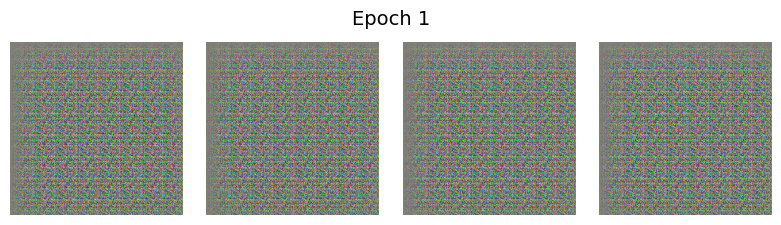

2025-06-19 14:50:34.379676: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:50:43.077415: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:50:52.002705: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:51:00.893596: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:51:10.400724: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:51:20.345179: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:51:29.965601: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch   20 | gen_loss = 2.6927 | disc_loss = 0.3520 | time = 9.64s


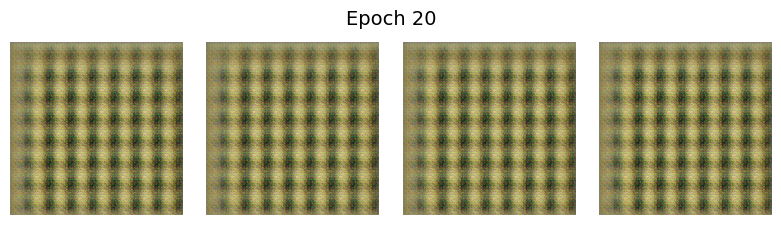

2025-06-19 14:53:33.511317: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:53:43.647531: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:53:53.172106: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:54:02.495680: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:54:11.791496: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:54:21.991644: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:54:32.103038: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch   40 | gen_loss = 4.6356 | disc_loss = 1.0668 | time = 9.37s


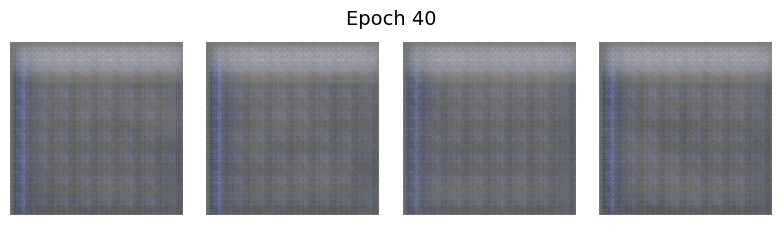

2025-06-19 14:56:47.276607: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:56:56.752904: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:57:06.268830: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:57:15.786395: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:57:25.257696: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:57:34.795389: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 14:57:44.216104: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch   60 | gen_loss = 2.5032 | disc_loss = 0.3734 | time = 9.47s


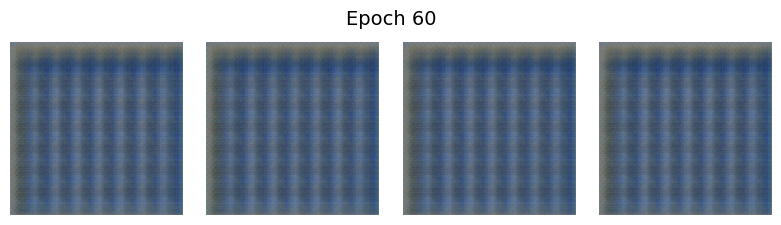

2025-06-19 14:59:56.931370: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:00:06.385543: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:00:15.748744: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:00:25.106800: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:00:34.587326: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:00:44.322868: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:00:53.872176: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch   80 | gen_loss = 2.2856 | disc_loss = 0.6714 | time = 9.83s


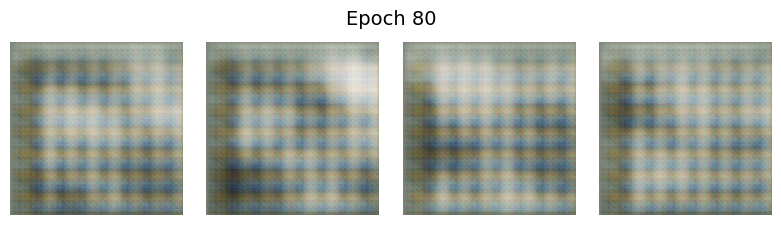

2025-06-19 15:03:09.194487: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:03:19.317889: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:03:28.353673: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:03:37.663244: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:03:47.344520: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:03:56.625687: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:04:06.151973: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  100 | gen_loss = 4.2343 | disc_loss = 0.6093 | time = 9.42s


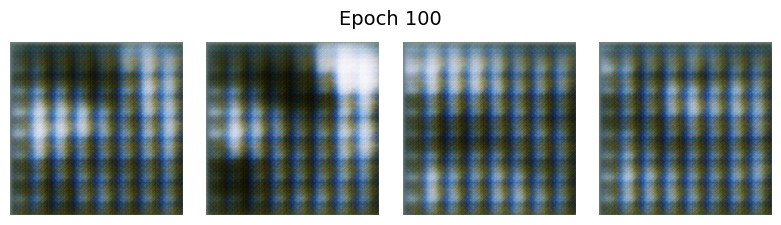

2025-06-19 15:06:18.647240: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:06:27.927595: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:06:37.227777: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:06:46.606056: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:06:56.039274: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:07:05.289195: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:07:14.621251: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  120 | gen_loss = 3.9676 | disc_loss = 0.5077 | time = 9.74s


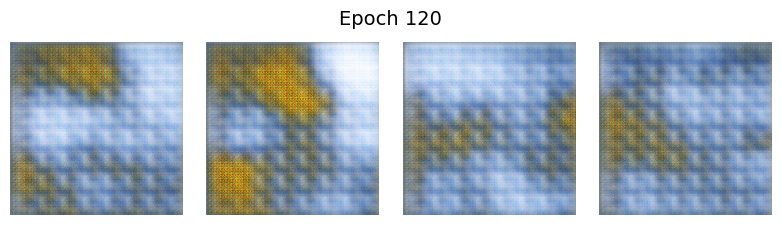

2025-06-19 15:09:31.137152: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:09:40.450866: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:09:49.784284: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:09:59.067712: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:10:08.474765: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:10:17.775516: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:10:27.105644: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  140 | gen_loss = 3.1422 | disc_loss = 0.3721 | time = 9.38s


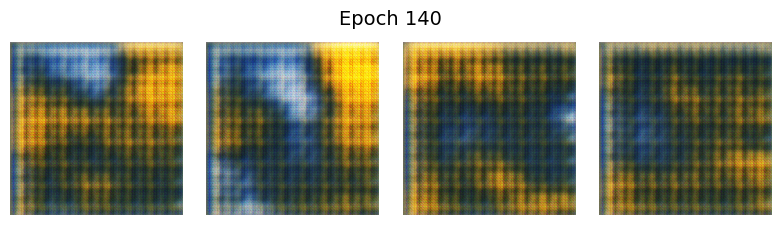

2025-06-19 15:12:37.741406: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:12:47.033823: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:12:56.505612: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:13:05.919989: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:13:15.827277: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:13:25.354985: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:13:34.663798: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  160 | gen_loss = 3.1425 | disc_loss = 0.4521 | time = 10.97s


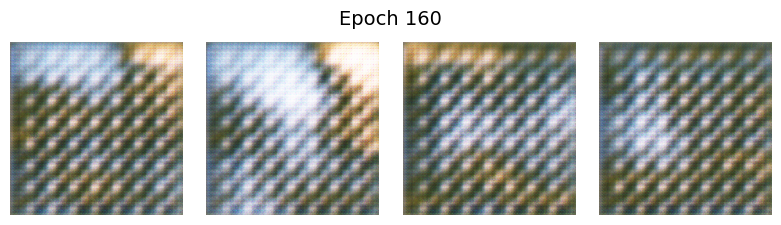

2025-06-19 15:16:08.843198: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:16:19.957820: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:16:30.979748: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:16:42.048300: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:16:53.023846: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:17:03.692201: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:17:14.393026: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  180 | gen_loss = 2.6342 | disc_loss = 0.3723 | time = 9.53s


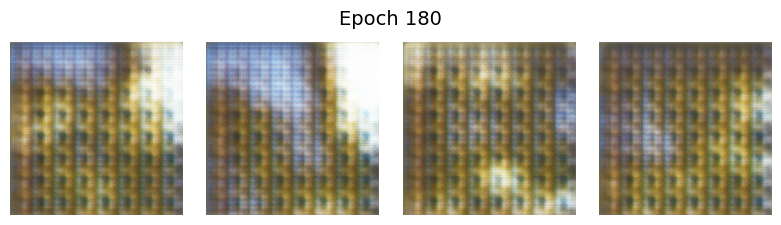

2025-06-19 15:19:33.122842: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:19:42.796071: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:19:52.332082: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:20:02.096788: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:20:11.565114: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:20:21.001583: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:20:30.501129: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  200 | gen_loss = 4.0957 | disc_loss = 0.9374 | time = 9.42s


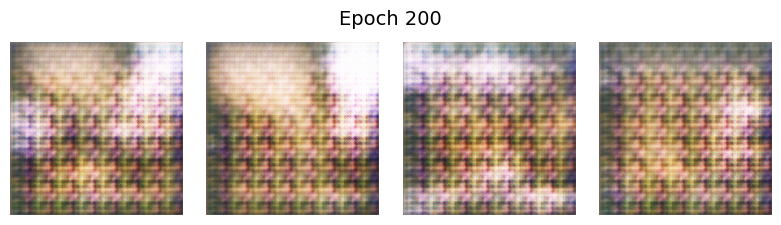

2025-06-19 15:22:43.424700: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:22:53.012983: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:23:02.439037: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:23:11.824854: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:23:21.505312: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:23:30.907734: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:23:40.464396: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  220 | gen_loss = 2.8249 | disc_loss = 0.4966 | time = 9.21s


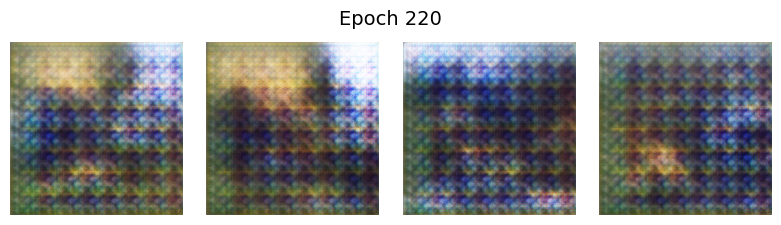

2025-06-19 15:25:55.027978: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:26:04.269152: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:26:13.698505: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:26:23.245667: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:26:32.595445: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:26:42.020594: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:26:51.453739: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  240 | gen_loss = 2.7657 | disc_loss = 0.6666 | time = 9.24s


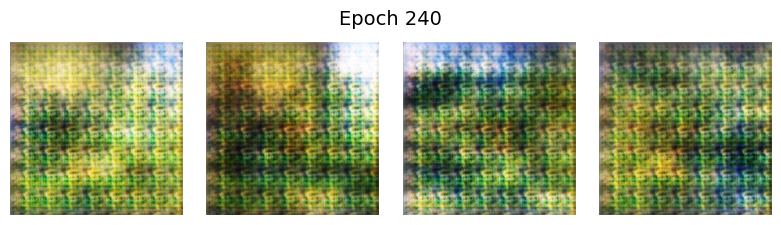

2025-06-19 15:29:01.163172: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:29:10.394737: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:29:19.499215: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:29:28.503580: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:29:37.277115: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:29:45.978369: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:29:54.734552: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  260 | gen_loss = 2.0078 | disc_loss = 0.7178 | time = 8.77s


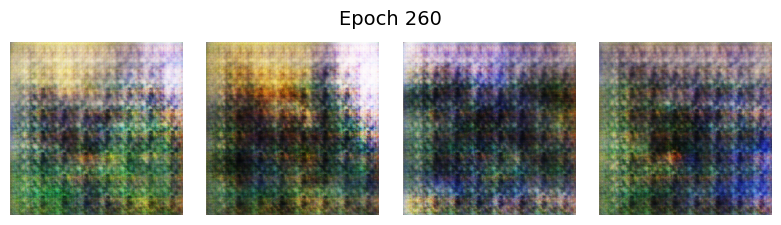

2025-06-19 15:31:58.157844: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:32:06.816583: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:32:15.716417: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:32:24.357975: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:32:33.148041: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:32:41.904494: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:32:50.972337: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  280 | gen_loss = 3.1143 | disc_loss = 0.9192 | time = 9.36s


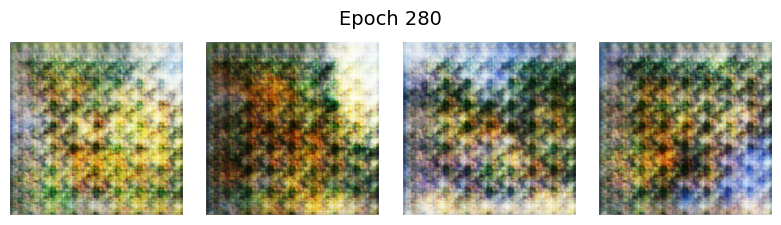

2025-06-19 15:35:01.794725: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:35:11.136217: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:35:20.410795: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:35:29.620833: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:35:38.867726: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:35:48.113827: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:35:57.512974: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  300 | gen_loss = 3.3602 | disc_loss = 0.8393 | time = 9.29s


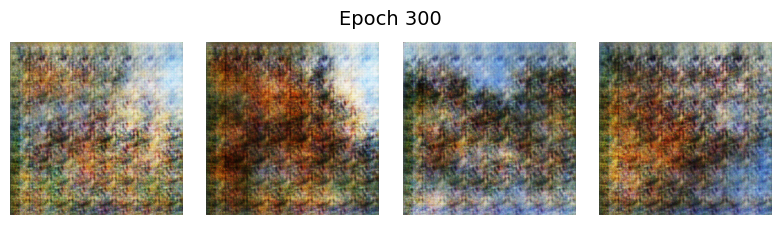

2025-06-19 15:38:07.956091: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:38:17.575117: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:38:26.985894: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:38:36.428614: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:38:45.744777: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:38:54.969510: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:39:04.280357: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  320 | gen_loss = 2.3311 | disc_loss = 0.5985 | time = 12.91s


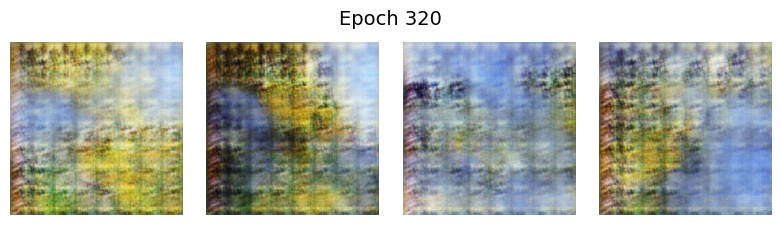

2025-06-19 15:41:27.634954: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:41:40.493233: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:41:53.163709: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:42:05.972232: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:42:18.497144: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:42:29.931598: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:42:42.581409: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  340 | gen_loss = 3.7534 | disc_loss = 0.7419 | time = 11.19s


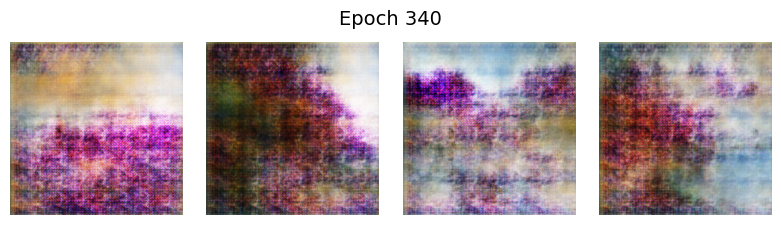

2025-06-19 15:45:21.698211: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:45:32.897796: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:45:44.173301: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:45:55.920692: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:46:07.676566: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:46:18.898776: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:46:30.068493: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  360 | gen_loss = 4.6907 | disc_loss = 0.4650 | time = 9.03s


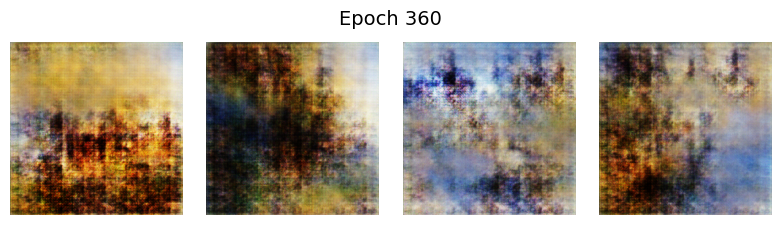

2025-06-19 15:48:53.260130: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:49:02.436615: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:49:11.262020: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:49:20.078762: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:49:29.137575: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:49:38.038643: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:49:46.808065: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  380 | gen_loss = 4.4150 | disc_loss = 0.5549 | time = 9.18s


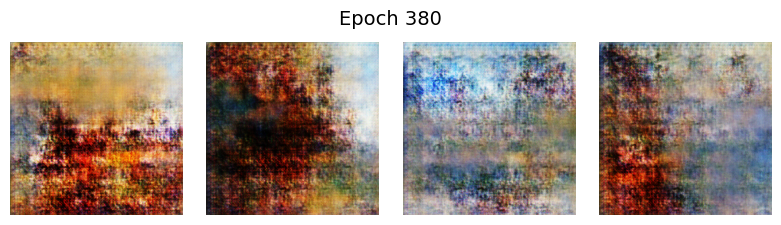

2025-06-19 15:51:54.032333: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:52:03.131840: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:52:12.305419: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:52:21.308888: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:52:30.108314: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:52:38.884622: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:52:47.672350: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  400 | gen_loss = 3.9237 | disc_loss = 0.3689 | time = 8.83s


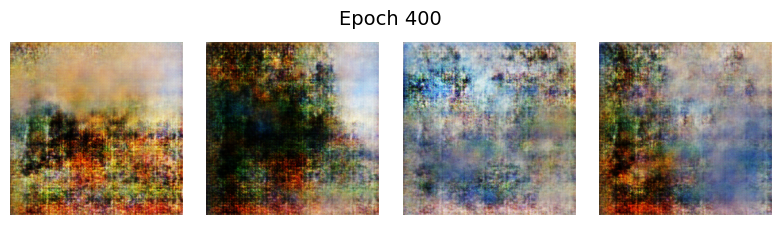

2025-06-19 15:54:51.292184: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:55:00.034555: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:55:08.821535: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:55:17.549867: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:55:26.702513: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:55:35.435914: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:55:44.539034: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  420 | gen_loss = 5.9196 | disc_loss = 0.4351 | time = 8.71s


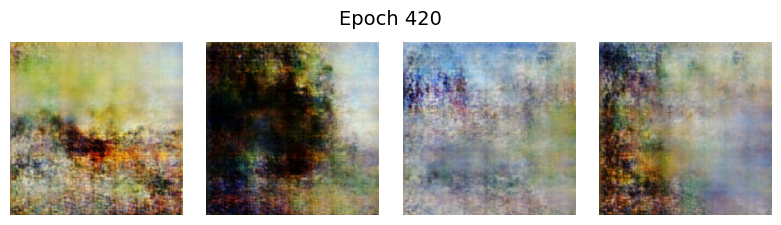

2025-06-19 15:57:51.081582: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:57:59.912245: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:58:08.847880: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:58:17.525008: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:58:26.353410: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:58:35.378822: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 15:58:44.221537: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  440 | gen_loss = 3.5143 | disc_loss = 0.3722 | time = 9.27s


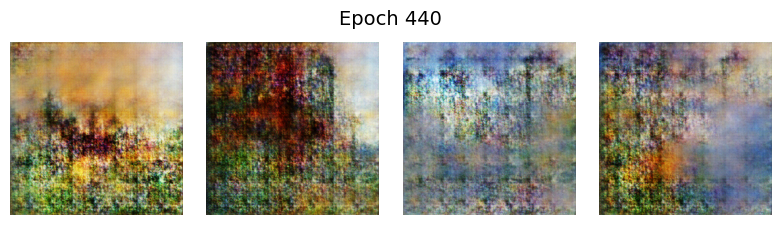

2025-06-19 16:00:53.909912: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:01:03.279118: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:01:13.160220: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:01:22.838041: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:01:32.186999: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:01:41.457923: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:01:50.631061: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  460 | gen_loss = 3.5769 | disc_loss = 0.2604 | time = 10.35s


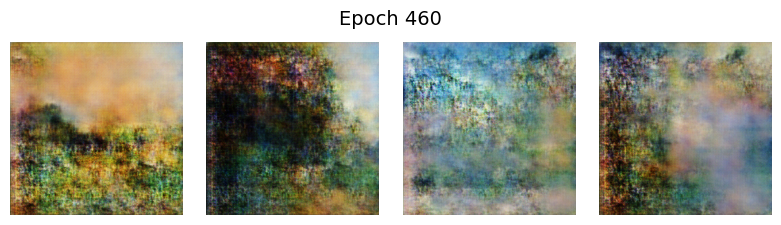

2025-06-19 16:04:04.965983: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:04:14.279597: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:04:23.601609: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:04:32.966658: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:04:42.383565: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:04:51.706952: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:05:01.120206: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  480 | gen_loss = 4.9097 | disc_loss = 0.2607 | time = 9.48s


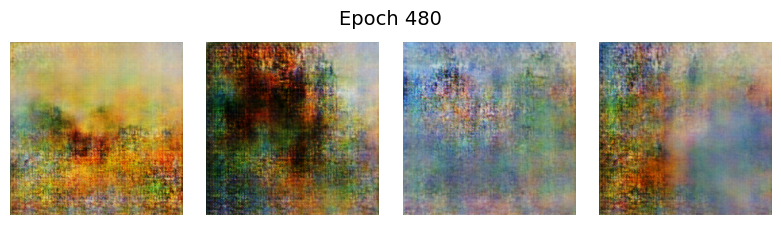

2025-06-19 16:07:12.823797: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:07:22.213410: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:07:31.672246: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:07:41.139639: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:07:50.516947: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:08:00.022872: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:08:09.447246: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  500 | gen_loss = 4.3670 | disc_loss = 0.1863 | time = 9.99s


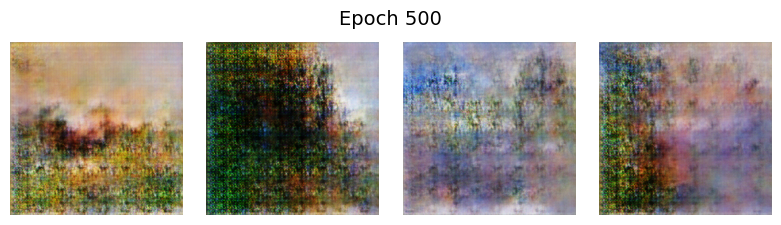

2025-06-19 16:10:26.518401: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:10:36.038570: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:10:45.468621: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:10:55.373013: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:11:05.023381: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:11:15.048905: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:11:24.724365: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  520 | gen_loss = 7.4977 | disc_loss = 0.3471 | time = 9.39s


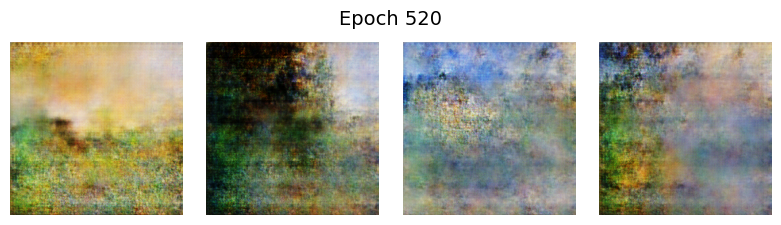

2025-06-19 16:13:39.013152: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:13:48.558913: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:13:58.355568: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:14:07.998395: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:14:17.630889: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:14:27.053294: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:14:36.291514: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  540 | gen_loss = 6.9167 | disc_loss = 0.2302 | time = 9.48s


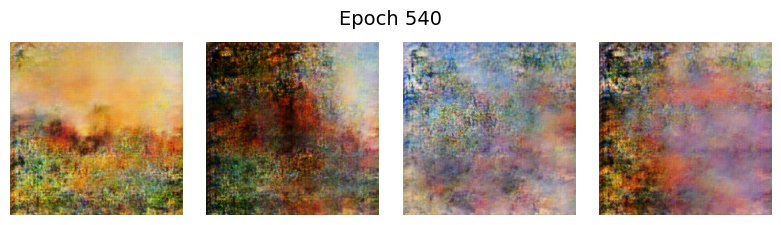

2025-06-19 16:16:48.793008: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:16:58.250777: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:17:07.675453: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:17:17.436899: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:17:27.037058: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:17:36.390438: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:17:45.757023: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  560 | gen_loss = 5.9401 | disc_loss = 0.1373 | time = 9.33s


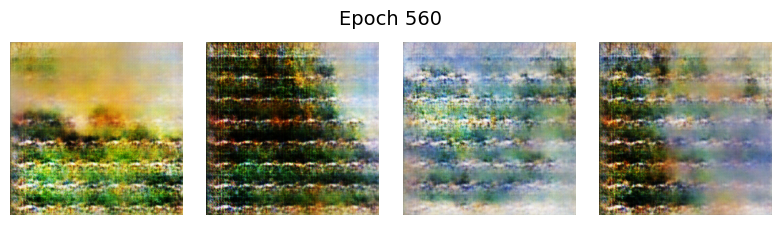

2025-06-19 16:19:58.183548: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:20:07.752069: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:20:17.270401: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:20:26.767099: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:20:36.217149: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:20:45.914559: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:20:55.832069: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  580 | gen_loss = 4.7796 | disc_loss = 0.2563 | time = 9.44s


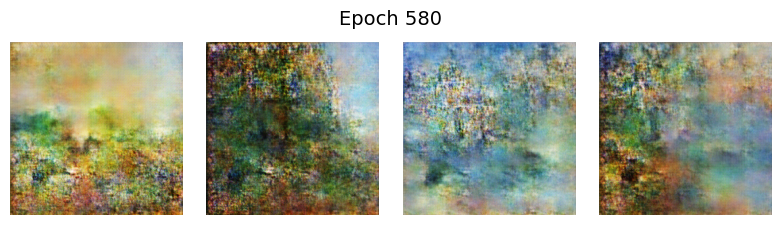

2025-06-19 16:23:10.355521: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:23:19.857465: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:23:29.408420: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:23:38.872690: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:23:48.258283: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:23:57.711603: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:24:07.165659: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  600 | gen_loss = 7.4828 | disc_loss = 0.2438 | time = 8.80s


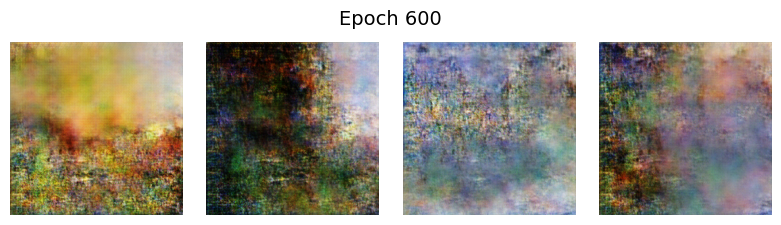

2025-06-19 16:26:11.046985: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:26:19.779862: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:26:28.566602: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:26:37.425300: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:26:46.301955: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:26:55.648169: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:27:05.009180: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  620 | gen_loss = 6.8383 | disc_loss = 0.1283 | time = 8.86s


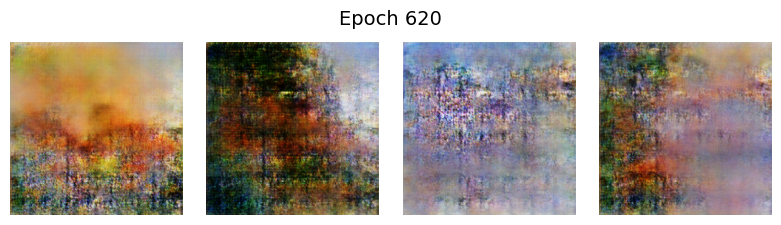

2025-06-19 16:29:10.838674: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:29:19.949573: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:29:29.015928: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:29:38.214803: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:29:47.365274: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:29:56.615512: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:30:05.981843: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  640 | gen_loss = 7.2127 | disc_loss = 0.2631 | time = 9.61s


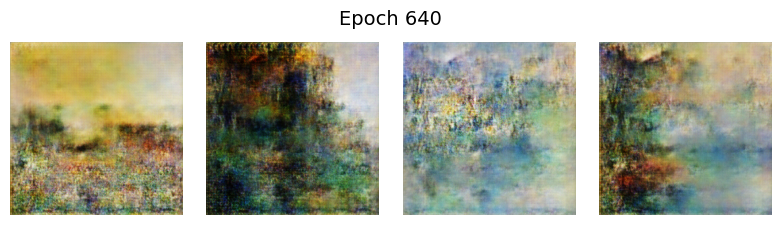

2025-06-19 16:32:16.662596: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:32:26.042450: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:32:35.273726: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:32:44.487351: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:32:53.606006: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:33:02.815331: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:33:12.360809: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  660 | gen_loss = 9.9895 | disc_loss = 0.3994 | time = 9.18s


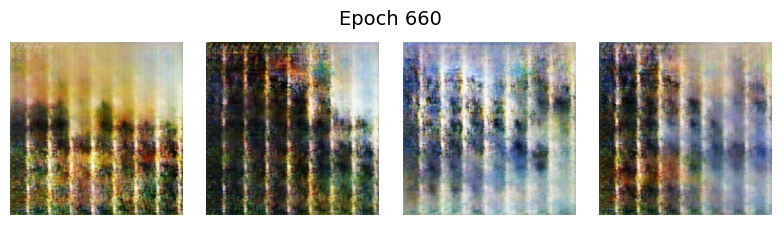

2025-06-19 16:35:21.671619: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:35:30.936916: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:35:40.148226: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:35:49.693051: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:35:58.867243: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:36:08.078614: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:36:17.650056: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  680 | gen_loss = 6.4864 | disc_loss = 0.1262 | time = 9.67s


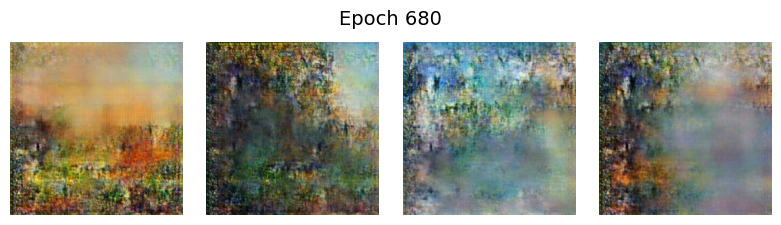

2025-06-19 16:38:31.772958: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:38:41.062529: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:38:50.240505: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:38:59.608179: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:39:08.894125: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:39:18.632850: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:39:28.003994: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  700 | gen_loss = 6.6030 | disc_loss = 0.1586 | time = 9.11s


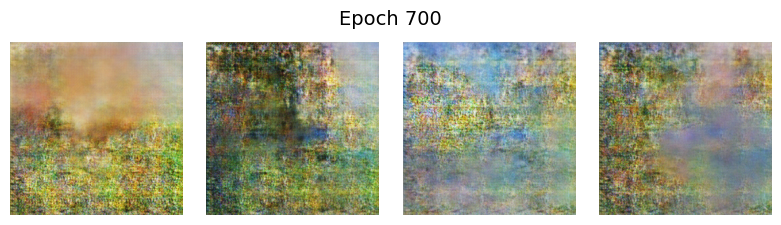

2025-06-19 16:41:39.317099: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:41:48.496244: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:41:57.648952: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:42:06.837222: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:42:16.568140: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:42:25.939714: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:42:35.142345: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  720 | gen_loss = 6.8373 | disc_loss = 0.1809 | time = 9.48s


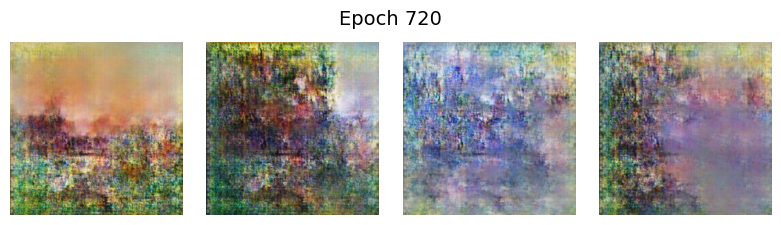

2025-06-19 16:44:45.249512: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:44:54.469412: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:45:03.667443: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:45:12.805872: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:45:22.311360: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:45:31.579502: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:45:40.852375: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  740 | gen_loss = 8.5527 | disc_loss = 0.1950 | time = 9.23s


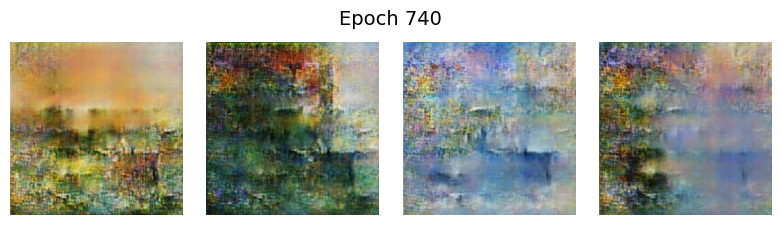

2025-06-19 16:47:50.210617: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:47:59.485147: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:48:08.760124: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:48:18.021899: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:48:27.187853: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:48:36.319196: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:48:45.444047: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  760 | gen_loss = 6.1297 | disc_loss = 0.1225 | time = 9.58s


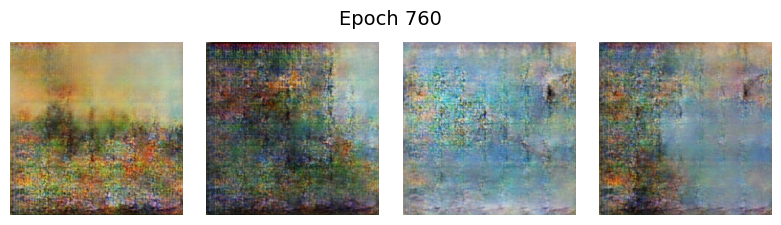

2025-06-19 16:50:54.831444: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:51:04.021394: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:51:13.201866: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:51:22.407996: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:51:31.503390: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:51:40.621085: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:51:49.987786: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  780 | gen_loss = 7.9440 | disc_loss = 0.2057 | time = 9.30s


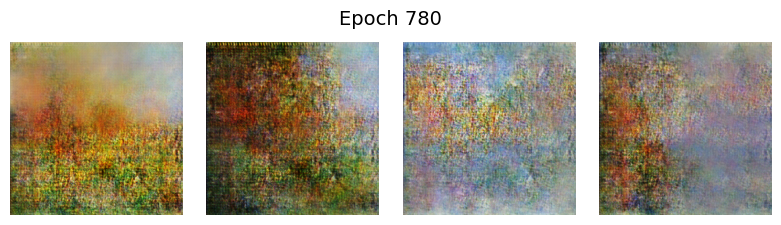

2025-06-19 16:54:04.379495: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:54:13.993927: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:54:23.418427: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:54:32.913594: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:54:42.115409: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:54:51.263347: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:55:00.346227: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  800 | gen_loss = 11.2659 | disc_loss = 0.2361 | time = 9.26s


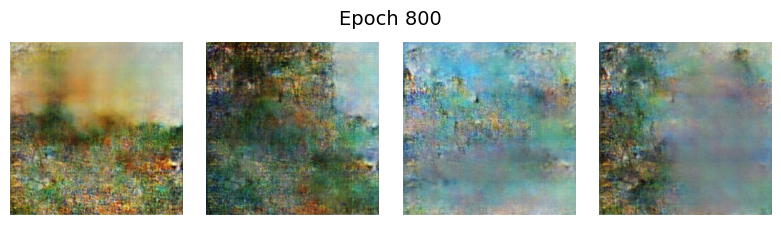

2025-06-19 16:57:14.653141: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:57:24.135228: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:57:33.258391: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:57:42.553724: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:57:51.718170: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:58:01.235501: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 16:58:10.517026: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  820 | gen_loss = 7.2786 | disc_loss = 0.1363 | time = 9.25s


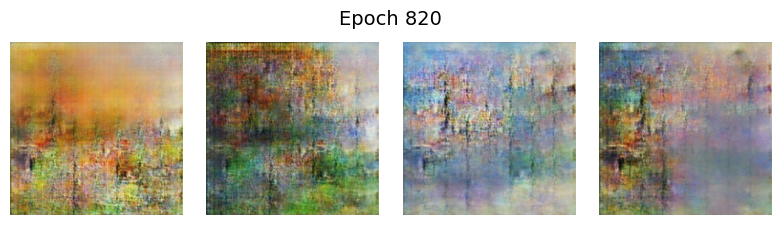

2025-06-19 17:00:19.791605: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:00:29.175191: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:00:38.552941: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:00:47.793110: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:00:57.059280: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:01:06.211246: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:01:15.418524: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  840 | gen_loss = 9.7071 | disc_loss = 0.1802 | time = 9.14s


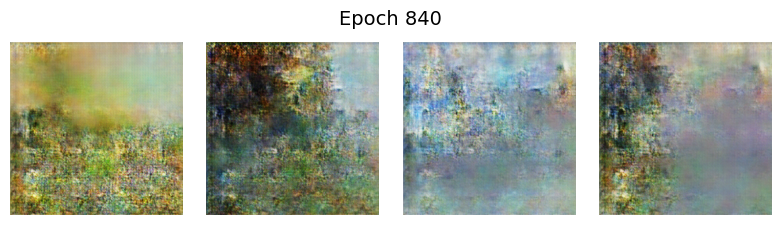

2025-06-19 17:03:24.829624: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:03:33.996059: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:03:43.141029: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:03:52.658972: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:04:01.912480: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:04:11.686686: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:04:21.232763: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  860 | gen_loss = 13.1240 | disc_loss = 0.1669 | time = 9.63s


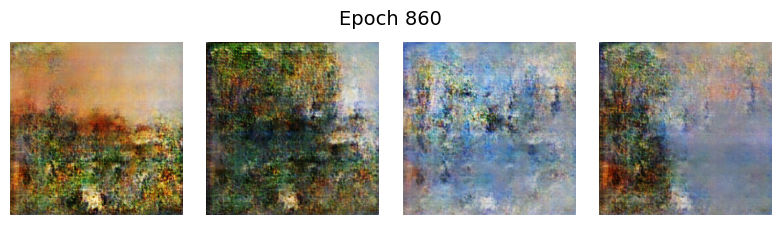

2025-06-19 17:06:30.307040: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:06:39.552111: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:06:48.519649: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:06:57.350547: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:07:06.599461: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:07:16.342655: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:07:25.683447: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  880 | gen_loss = 10.7663 | disc_loss = 0.1223 | time = 9.57s


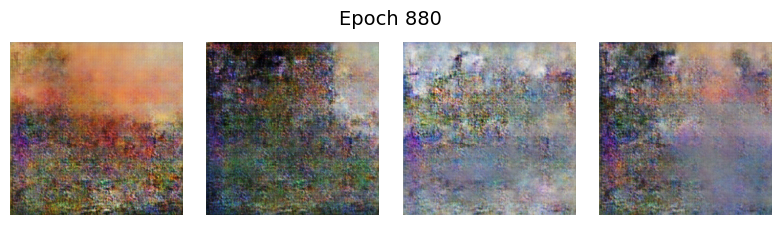

2025-06-19 17:09:35.351881: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:09:44.525816: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:09:53.731771: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:10:02.941320: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:10:12.138830: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:10:21.726638: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:10:30.914210: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  900 | gen_loss = 8.2417 | disc_loss = 0.1698 | time = 9.19s


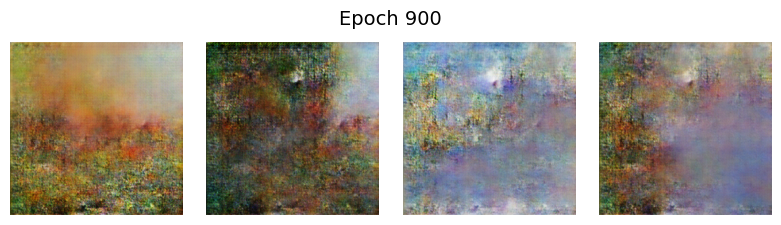

2025-06-19 17:12:39.625133: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:12:48.723738: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:12:57.823989: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:13:06.953554: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:13:16.073895: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:13:25.126755: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:13:34.130965: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  920 | gen_loss = 9.4856 | disc_loss = 0.1759 | time = 9.19s


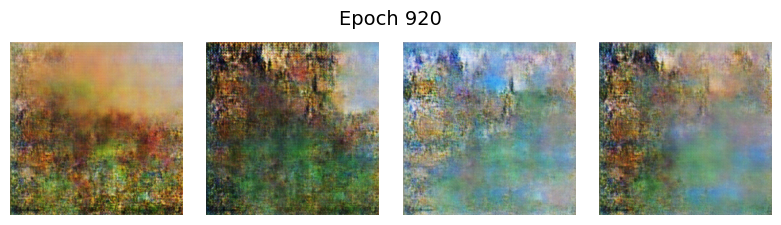

2025-06-19 17:15:44.288330: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:15:53.812665: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:16:02.997443: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:16:12.038581: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:16:21.322026: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:16:30.431657: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:16:39.570046: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  940 | gen_loss = 13.4974 | disc_loss = 0.2424 | time = 9.16s


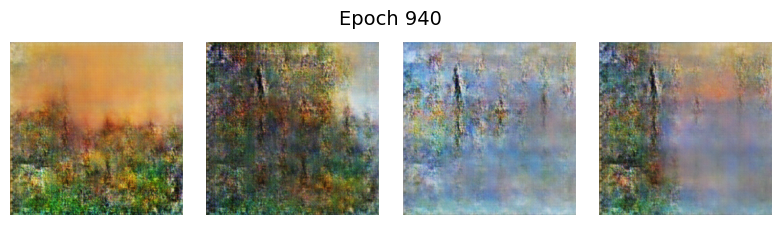

2025-06-19 17:18:49.424968: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:18:58.655411: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:19:08.171196: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:19:17.865878: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:19:27.069086: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:19:36.171256: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:19:45.353811: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  960 | gen_loss = 9.6636 | disc_loss = 0.1217 | time = 9.17s


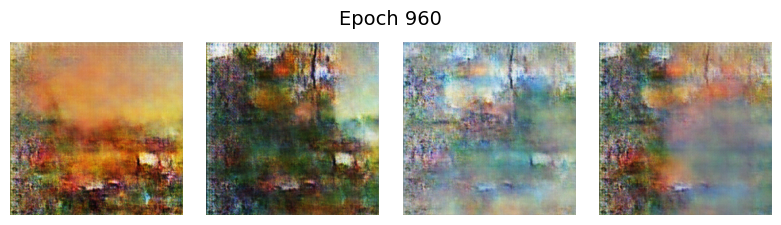

2025-06-19 17:21:54.520216: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:22:03.635752: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:22:12.779432: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:22:22.240475: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:22:31.482988: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:22:40.874183: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:22:50.024894: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch  980 | gen_loss = 16.3043 | disc_loss = 0.3369 | time = 9.24s


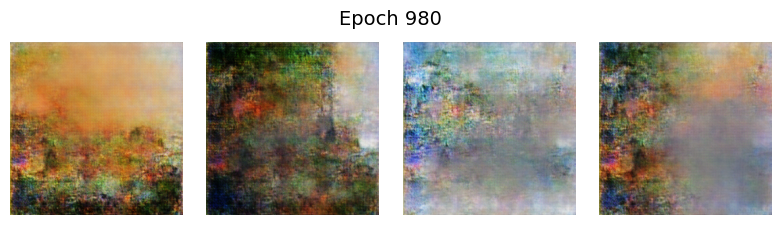

2025-06-19 17:24:58.839762: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:25:07.968549: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:25:17.178211: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:25:26.407086: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:25:35.701389: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:25:45.098962: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:25:54.214198: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1000 | gen_loss = 11.1024 | disc_loss = 0.2677 | time = 9.49s


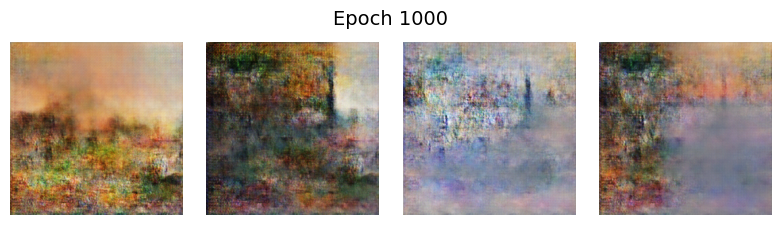

2025-06-19 17:28:03.293807: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:28:13.147068: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:28:22.741747: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:28:31.806183: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:28:40.978049: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:28:50.088955: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:28:58.912110: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1020 | gen_loss = 9.9865 | disc_loss = 0.1168 | time = 8.74s


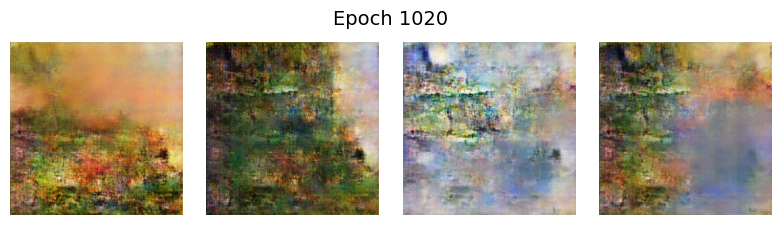

2025-06-19 17:31:02.343347: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:31:11.465406: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:31:20.669906: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:31:29.415501: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:31:38.139197: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:31:46.802886: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:31:55.525812: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1040 | gen_loss = 12.8345 | disc_loss = 0.1718 | time = 8.83s


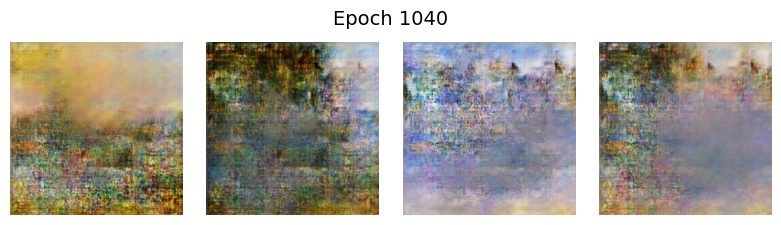

2025-06-19 17:34:01.108652: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:34:10.001976: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:34:18.934079: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:34:27.875996: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:34:37.156966: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:34:46.495958: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:34:56.043287: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1060 | gen_loss = 12.2003 | disc_loss = 0.1008 | time = 8.83s


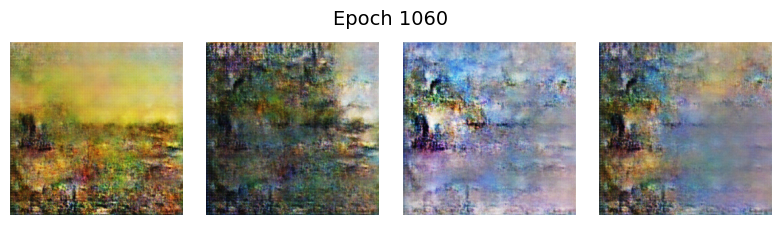

2025-06-19 17:37:02.673955: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:37:11.490598: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:37:20.242850: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:37:28.928694: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:37:37.785533: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:37:47.126800: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:37:57.940400: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1080 | gen_loss = 17.5576 | disc_loss = 0.2618 | time = 9.52s


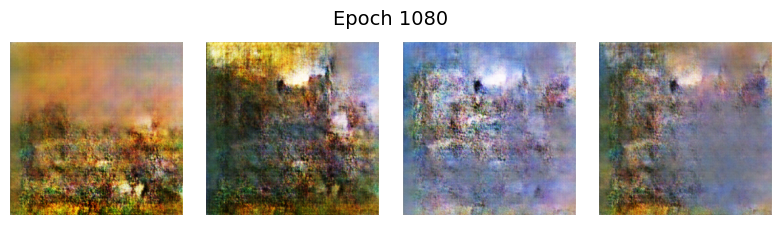

2025-06-19 17:40:11.281873: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:40:21.163773: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:40:30.549117: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:40:39.955523: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:40:49.382485: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:40:58.822849: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:41:08.179468: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1100 | gen_loss = 12.4362 | disc_loss = 0.2272 | time = 9.46s


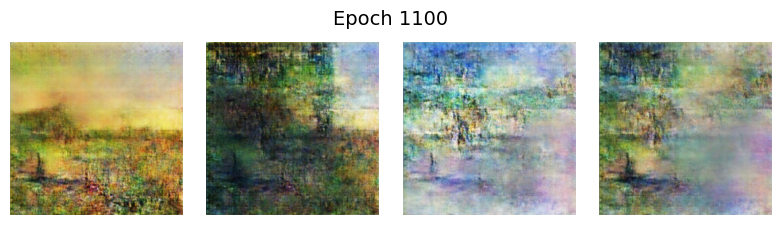

2025-06-19 17:43:21.852395: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:43:31.450936: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:43:40.942088: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:43:50.392570: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:43:59.874049: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:44:09.410382: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:44:18.942112: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1120 | gen_loss = 10.6731 | disc_loss = 0.1789 | time = 9.47s


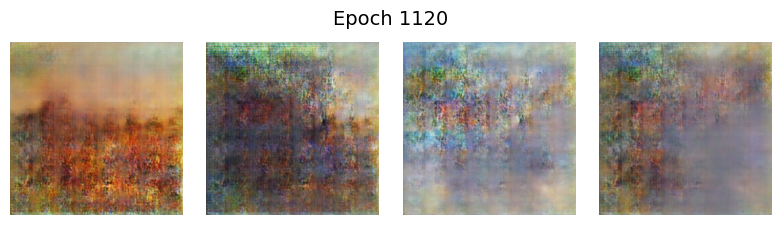

2025-06-19 17:46:32.080733: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:46:41.770564: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:46:51.150379: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:47:00.540778: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:47:10.738681: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:47:21.305533: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:47:31.329645: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1140 | gen_loss = 9.6628 | disc_loss = 0.1055 | time = 9.49s


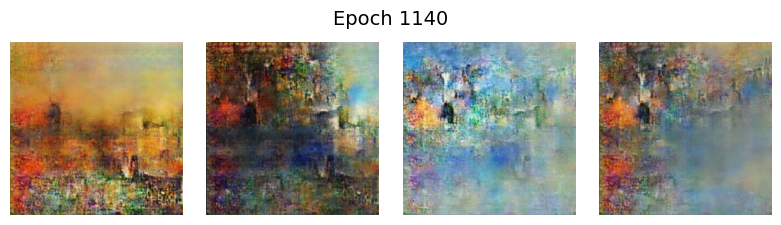

2025-06-19 17:49:44.179991: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:49:53.994249: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:50:03.366441: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:50:13.122773: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:50:22.576069: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:50:31.854135: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:50:41.077210: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1160 | gen_loss = 18.0873 | disc_loss = 0.3784 | time = 9.54s


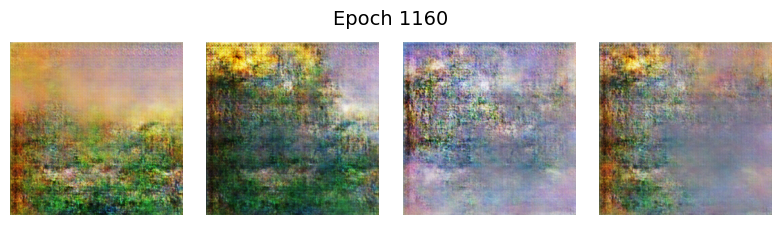

2025-06-19 17:52:56.575937: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:53:06.334555: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:53:16.351001: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:53:26.177614: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:53:35.696974: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:53:45.280481: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:53:54.784233: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1180 | gen_loss = 12.8926 | disc_loss = 0.1993 | time = 9.59s


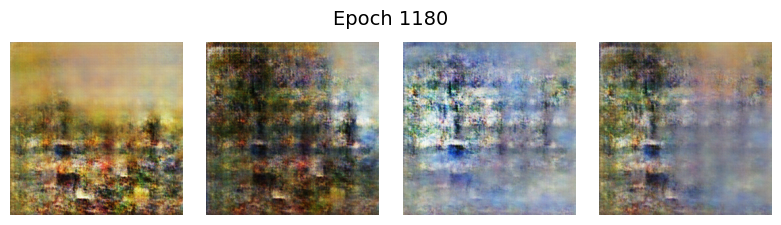

2025-06-19 17:56:08.507069: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:56:17.994050: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:56:27.491336: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:56:37.022665: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:56:46.525387: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:56:56.086691: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:57:05.637436: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1200 | gen_loss = 9.0720 | disc_loss = 0.1455 | time = 8.88s


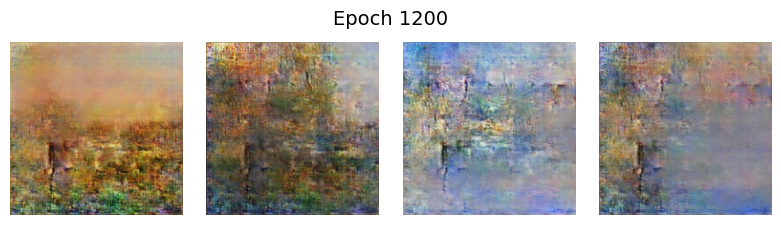

2025-06-19 17:59:16.896859: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:59:25.840895: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:59:34.634756: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:59:43.471781: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 17:59:52.623261: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:00:01.615846: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:00:11.282260: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1220 | gen_loss = 16.2139 | disc_loss = 0.2375 | time = 9.17s


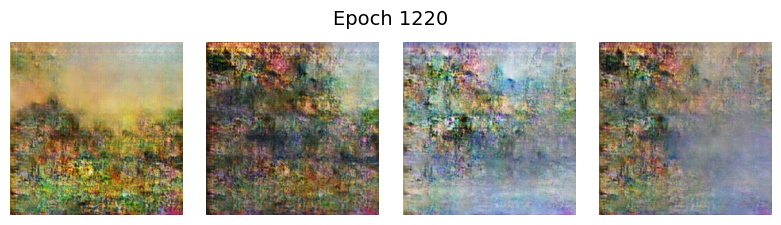

2025-06-19 18:02:21.195126: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:02:30.557685: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:02:40.205375: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:02:49.825925: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:02:59.602889: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:03:09.596660: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:03:19.535382: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1240 | gen_loss = 12.2218 | disc_loss = 0.0985 | time = 9.72s


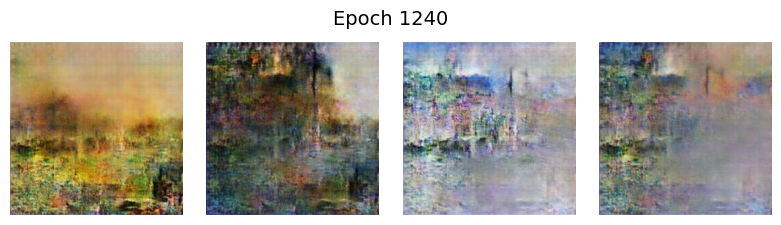

2025-06-19 18:05:31.044525: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:05:40.206796: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:05:49.344769: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:05:58.441522: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:06:07.564844: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:06:16.615236: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:06:25.975652: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1260 | gen_loss = 11.0623 | disc_loss = 0.0877 | time = 9.22s


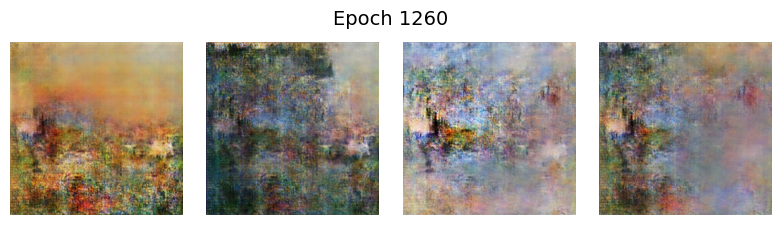

2025-06-19 18:08:35.496475: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:08:44.858549: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:08:53.971005: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:09:03.012815: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:09:12.168254: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:09:21.254663: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:09:30.509932: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1280 | gen_loss = 10.2110 | disc_loss = 0.1613 | time = 9.17s


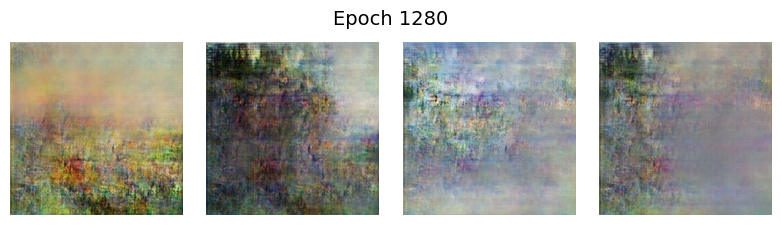

2025-06-19 18:11:39.918043: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:11:49.290014: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:11:58.698817: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:12:08.305101: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:12:17.963861: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:12:27.583276: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:12:37.000788: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1300 | gen_loss = 13.6174 | disc_loss = 0.2323 | time = 9.16s


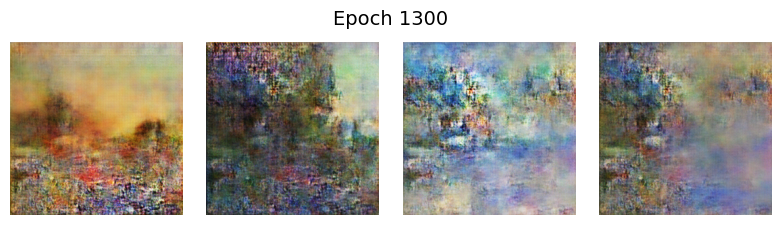

2025-06-19 18:14:46.767645: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:14:56.003239: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:15:05.397072: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:15:15.121137: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:15:24.553685: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:15:33.673089: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:15:42.890009: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1320 | gen_loss = 13.3599 | disc_loss = 0.1293 | time = 9.19s


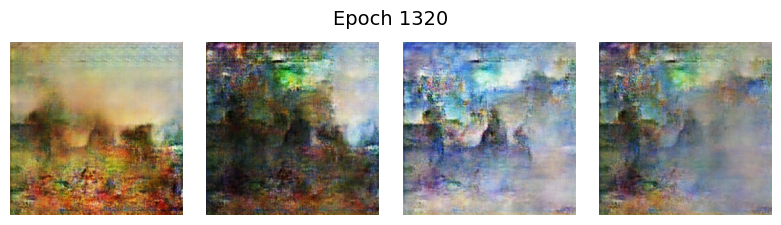

2025-06-19 18:17:52.957872: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:18:02.196021: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:18:11.302600: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:18:20.777630: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:18:30.181826: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:18:39.347746: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:18:48.514190: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1340 | gen_loss = 10.8012 | disc_loss = 0.1139 | time = 9.15s


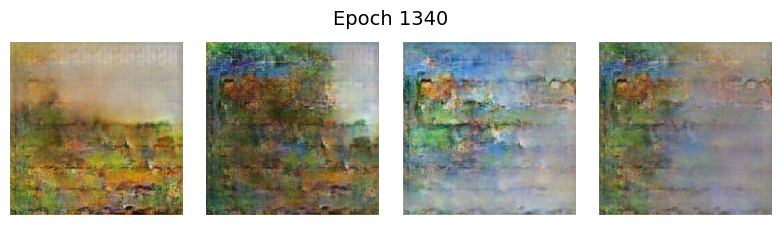

2025-06-19 18:20:57.069731: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:21:06.202309: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:21:15.428364: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:21:24.621833: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:21:33.941650: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:21:43.315214: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:21:52.696683: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1360 | gen_loss = 16.9334 | disc_loss = 0.2189 | time = 9.33s


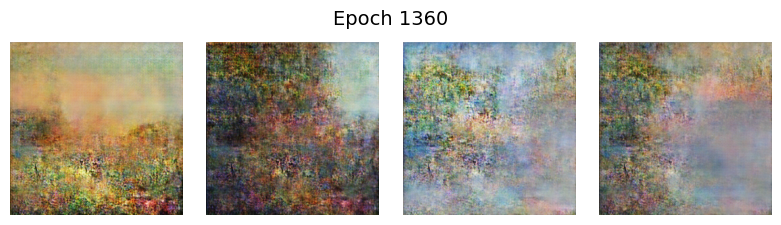

2025-06-19 18:24:02.377251: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:24:11.995361: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:24:21.552222: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:24:30.634658: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:24:39.858849: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:24:48.976363: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:24:58.100775: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1380 | gen_loss = 16.3561 | disc_loss = 0.1024 | time = 9.14s


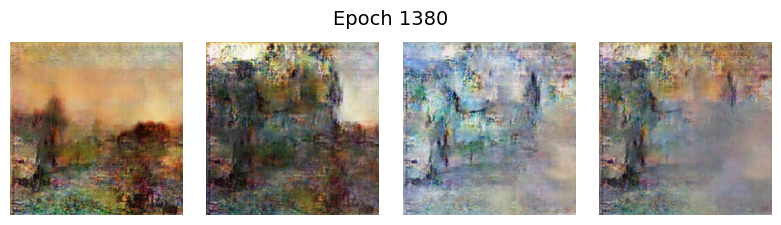

2025-06-19 18:27:08.278684: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:27:17.846225: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:27:27.120469: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:27:36.315815: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:27:45.470674: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:27:54.680552: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:28:03.811304: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1400 | gen_loss = 17.3191 | disc_loss = 0.1205 | time = 9.19s


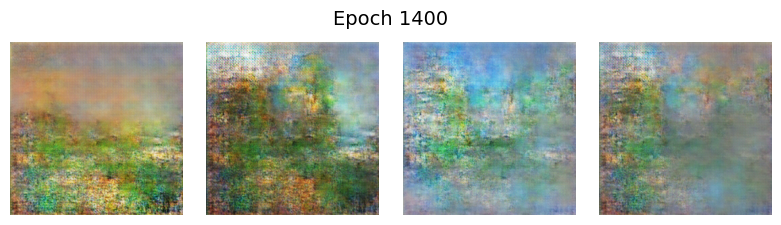

2025-06-19 18:30:14.059489: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:30:23.156985: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:30:32.335113: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:30:41.998181: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:30:51.160600: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:31:00.340802: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:31:09.771834: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1420 | gen_loss = 35.9001 | disc_loss = 9.0862 | time = 9.85s


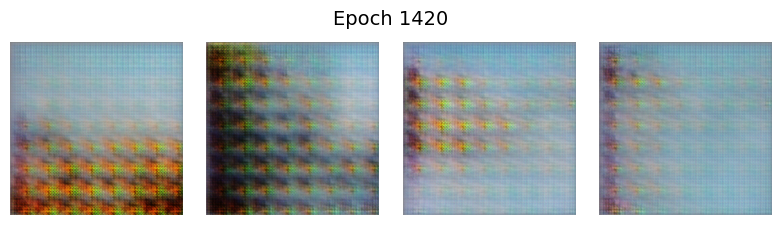

2025-06-19 18:33:20.743216: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:33:29.814918: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:33:38.911077: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:33:48.117227: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:33:57.298074: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:34:06.492206: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:34:15.742370: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1440 | gen_loss = 7.1219 | disc_loss = 0.3839 | time = 10.12s


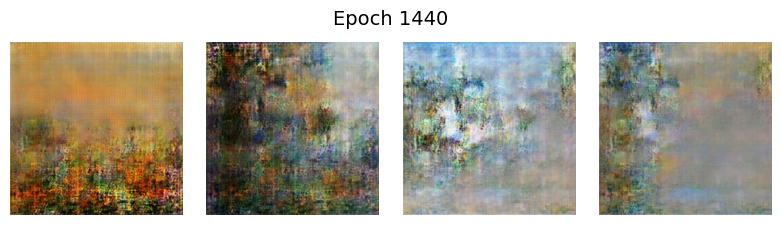

2025-06-19 18:36:28.214368: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:36:38.866879: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:36:49.279578: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:36:58.659487: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:37:08.354146: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:37:18.309494: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:37:27.900190: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1460 | gen_loss = 10.9534 | disc_loss = 0.1428 | time = 9.40s


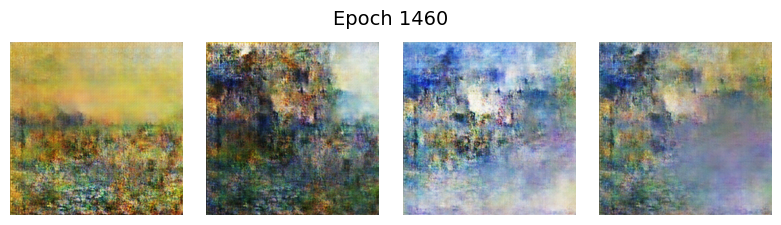

2025-06-19 18:39:41.281318: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:39:50.780267: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:40:00.235040: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:40:09.676027: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:40:19.248268: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:40:28.758770: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:40:38.421048: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1480 | gen_loss = 10.0936 | disc_loss = 0.2245 | time = 9.56s


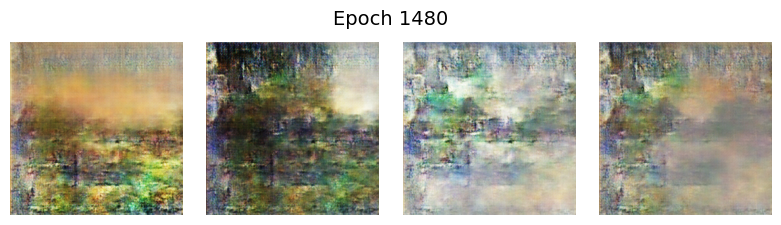

2025-06-19 18:42:52.613339: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:43:02.915892: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:43:13.267219: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:43:23.323555: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:43:33.056213: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:43:42.915676: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-06-19 18:43:53.206324: W tensorflow/core/framework/local_rendezvous.cc:404] L

Epoch 1500 | gen_loss = 11.4857 | disc_loss = 0.3868 | time = 9.53s


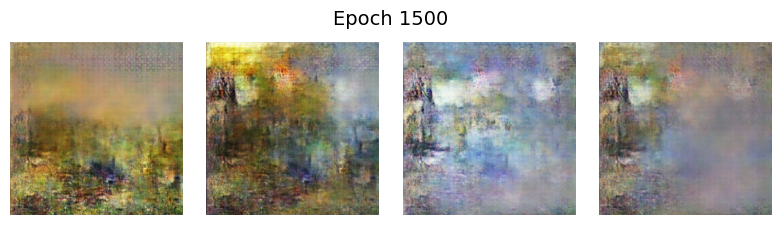

In [19]:
# ────────────────────────────────────────────────────────────────────────────────
#  XLA-aware helper (fixes the “platform not found” error on Apple Silicon)
# ────────────────────────────────────────────────────────────────────────────────
def _xla_supported() -> bool:
    """Return True when an XLA device (CPU/GPU) is available."""
    return any("XLA" in d.device_type for d in tf.config.list_logical_devices())

JIT_COMPILE = _xla_supported()          # False on M-series Macs
print(f"[INFO] jit_compile set to {JIT_COMPILE}")

# ────────────────────────────────────────────────────────────────────────────────
#  1.  Generator – identical architecture, better defaults
# ────────────────────────────────────────────────────────────────────────────────
def make_generator_model() -> tf.keras.Sequential:
    model = tf.keras.Sequential([
        layers.Dense(8 * 8 * 1024, use_bias=False, input_shape=(100,),
                     kernel_initializer="he_normal"),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Reshape((8, 8, 1024)),
        layers.Conv2DTranspose(512, (5, 5), strides=(2, 2),
                               padding="same", use_bias=False,
                               kernel_initializer="he_normal"),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2DTranspose(256, (5, 5), strides=(2, 2),
                               padding="same", use_bias=False,
                               kernel_initializer="he_normal"),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2DTranspose(128, (5, 5), strides=(2, 2),
                               padding="same", use_bias=False,
                               kernel_initializer="he_normal"),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2DTranspose(64, (5, 5), strides=(2, 2),
                               padding="same", use_bias=False,
                               kernel_initializer="he_normal"),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2DTranspose(3, (5, 5), strides=(2, 2),
                               padding="same", use_bias=False,
                               activation="tanh",
                               kernel_initializer="glorot_uniform"),
    ], name="generator")
    return model

# ────────────────────────────────────────────────────────────────────────────────
#  2.  Discriminator – identical logic, minor improvements
# ────────────────────────────────────────────────────────────────────────────────
def make_discriminator_model() -> tf.keras.Sequential:
    model = tf.keras.Sequential([
        layers.Conv2D(64, (5, 5), strides=(2, 2), padding="same",
                      input_shape=[256, 256, 3],
                      kernel_initializer="he_normal"),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        layers.Conv2D(128, (5, 5), strides=(2, 2), padding="same",
                      kernel_initializer="he_normal"),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        layers.Conv2D(256, (5, 5), strides=(2, 2), padding="same",
                      kernel_initializer="he_normal"),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        layers.Conv2D(512, (5, 5), strides=(2, 2), padding="same",
                      kernel_initializer="he_normal"),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        layers.Flatten(),
        layers.Dense(1),
    ], name="discriminator")
    return model

# ────────────────────────────────────────────────────────────────────────────────
#  3.  GAN losses – unchanged formulas
# ────────────────────────────────────────────────────────────────────────────────
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output: tf.Tensor) -> tf.Tensor:
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output: tf.Tensor, fake_output: tf.Tensor) -> tf.Tensor:
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

# ────────────────────────────────────────────────────────────────────────────────
#  4.  One training step – dynamic XLA flag
# ────────────────────────────────────────────────────────────────────────────────
@tf.function(jit_compile=JIT_COMPILE)
def train_step(
    images: tf.Tensor,
    generator: tf.keras.Model,
    discriminator: tf.keras.Model,
    generator_optimizer: tf.keras.optimizers.Optimizer,
    discriminator_optimizer: tf.keras.optimizers.Optimizer
) -> Tuple[tf.Tensor, tf.Tensor]:
    noise = tf.random.normal([tf.shape(images)[0], 100])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss  = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    generator_optimizer.apply_gradients(
        zip(gen_tape.gradient(gen_loss,  generator.trainable_variables),
            generator.trainable_variables))
    discriminator_optimizer.apply_gradients(
        zip(disc_tape.gradient(disc_loss, discriminator.trainable_variables),
            discriminator.trainable_variables))
    return gen_loss, disc_loss

# ────────────────────────────────────────────────────────────────────────────────
#  5.  Training loop – same logic
# ────────────────────────────────────────────────────────────────────────────────
def train(
    dataset: tf.data.Dataset,
    epochs: int,
    generator: tf.keras.Model,
    discriminator: tf.keras.Model,
    generator_optimizer: tf.keras.optimizers.Optimizer,
    discriminator_optimizer: tf.keras.optimizers.Optimizer
) -> None:
    for epoch in range(epochs):
        start = time.time()
        gen_loss_list: List[tf.Tensor]  = []
        disc_loss_list: List[tf.Tensor] = []

        for image_batch in dataset:
            gen_loss, disc_loss = train_step(
                image_batch, generator, discriminator,
                generator_optimizer, discriminator_optimizer
            )
            gen_loss_list.append(gen_loss)
            disc_loss_list.append(disc_loss)

        gen_loss_avg  = tf.reduce_mean(gen_loss_list)
        disc_loss_avg = tf.reduce_mean(disc_loss_list)

        if (epoch + 1) == 1 or (epoch + 1) % 20 == 0:
            print(
                f"Epoch {epoch + 1:4d} | "
                f"gen_loss = {gen_loss_avg:.4f} | "
                f"disc_loss = {disc_loss_avg:.4f} | "
                f"time = {time.time() - start:.2f}s"
            )
            generate_and_save_images(generator, epoch + 1, seed)

# ────────────────────────────────────────────────────────────────────────────────
#  6.  Preview utility
# ────────────────────────────────────────────────────────────────────────────────
def generate_and_save_images(
    model: tf.keras.Model, epoch: int, test_input: tf.Tensor
) -> None:
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(8, 8))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        img = (predictions[i] * 127.5 + 127.5).numpy().astype("uint8")
        plt.imshow(img)
        plt.axis("off")

    plt.suptitle(f"Epoch {epoch}", fontsize=14)
    plt.tight_layout()
    plt.show()

# ────────────────────────────────────────────────────────────────────────────────
#  7.  Dataset pipeline (assumes load_dataset is already defined)
# ────────────────────────────────────────────────────────────────────────────────
BATCH_SIZE = 32
tfrecord_files = [
    Input + "/monet_tfrec/monet00-60.tfrec",
    Input + "/monet_tfrec/monet04-60.tfrec",
    Input + "/monet_tfrec/monet08-60.tfrec",
    Input + "/monet_tfrec/monet12-60.tfrec",
    Input + "/monet_tfrec/monet16-60.tfrec",
]
dataset = load_dataset(tfrecord_files, BATCH_SIZE)

# ────────────────────────────────────────────────────────────────────────────────
#  8.  Models, optimizers, and seed
# ────────────────────────────────────────────────────────────────────────────────
generator     = make_generator_model()
discriminator = make_discriminator_model()

generator_optimizer     = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

num_examples_to_generate = 4
seed = tf.random.normal([num_examples_to_generate, 100])

# ────────────────────────────────────────────────────────────────────────────────
#  9.  Kick off training
# ────────────────────────────────────────────────────────────────────────────────
train(dataset, 1500, generator, discriminator,
      generator_optimizer, discriminator_optimizer)


In [20]:
def generate_and_save_images(
    model,
    total_images: int,
    directory: Union[str, Path],
    batch_size: int = 10
) -> None:
    """
    Generates `total_images` from `model` and saves them as JPEGs.

    Args:
        model: Trained generator that maps a (batch, 100) noise tensor → image tensor.
        total_images (int): Desired number of output images.
        directory (str | Path): Directory where JPEGs will be written.
        batch_size (int, optional): Images per forward pass. Defaults to 10.
    """
    directory = Path(directory)
    directory.mkdir(parents=True, exist_ok=True)  # same logic, more robust

    # Iterate in mini-batches to avoid GPU/CPU memory spikes
    for batch_start in range(0, total_images, batch_size):
        batch_end = min(batch_start + batch_size, total_images)
        num_images = batch_end - batch_start

        # Noise tensor → synthetic images
        noise = tf.random.normal([num_images, 100])
        predictions = model(noise, training=False)

        # Scale to [0, 255] once per batch (vectorized)
        predictions = (predictions * 127.5 + 127.5).numpy().astype("uint8")

        # Write each JPEG to disk
        for i, img in enumerate(predictions):
            img_path = directory / f"image_{batch_start + i + 1:03d}.jpg"

            # Fast, TensorFlow-native encoder—avoids PIL overhead
            tf.io.write_file(
                str(img_path),
                tf.io.encode_jpeg(img, quality=95, optimize_size=True)
            )

In [30]:
from pathlib import Path
import shutil

# Directory that will hold the JPEGs
output_dir = Path("../images")

# Generate 7 000 images and save them
generate_and_save_images(generator, 7000, output_dir)

# Confirm generation
print("Images saved in:", output_dir.resolve())
print("Image count:", len(list(output_dir.glob("image_*.jpg"))))  # should be 7000

# ── Zip the folder ──────────────────────────────────────────────────────────
zip_path = output_dir.with_suffix(".zip")      # → ../images.zip
if zip_path.exists():
    zip_path.unlink()                          # overwrite if it already exists

shutil.make_archive(
    base_name=str(zip_path.with_suffix("")),   # "../images"
    format="zip",
    root_dir=str(output_dir),
    base_dir="."
)

print("ZIP archive created at:", zip_path.resolve())

Images saved in: /Users/devsxae/Developer/Personal/MSDS/Deep Learning/images
Image count: 7000
ZIP archive created at: /Users/devsxae/Developer/Personal/MSDS/Deep Learning/images.zip


In [32]:
!ls

Learning            gan-getting-started monet_gans.ipynb


We demonstrated that a GAN can generate Monet-inspired images, but with our limited training time, a human can still easily tell real Monets apart from the fakes. Although the model captures Monet’s characteristic color palettes, it fails to reproduce the compositional and figurative elements that define his work. Longer training might help, but there’s no guarantee the GAN could master those subtleties.

Rather than using a CycleGAN for style transfer, we built a DCGAN that generates images from scratch. A direct comparison of these two approaches would be valuable, but it lies beyond the scope of this mini-project.
